## Project 4
## Name: Harries, Robathan Tobias Bonnell
## Date submitted: 8 June
## Score: 20/20

[A] 3/3

[B] 2/2

[C] 8/8

[D] 1/1

[E] 1/1

[F] 1/1

[G] 3/3

[H] 1/1

#### Comments: 
Well done!

## Rubric
Code Tests

[A] (3 pts) If code tests are suggested, all such tests are completed.  If code tests aren’t suggested, student has articulated their own code tests and executed those tests to show that code is working properly in at least some small number of obvious cases.  The more robust the code tests are, the better.

[B] (2 pts) All code tests are explained in complete sentences in text cells (along with any relevant mathematics).  There is a reasonable amount of explanation of how one knows that the code tests have been passed.

Application of Code to Physical Systems Modeling

[C] (8 pts) Notebook contains a mixture of explanation text in complete sentences (with math where appropriate) and graphs/other visual representations illustrating how the computer model exhibits the relevant phenomena predicted by the mathematical model of the system.  All prompts have been answered.

General

[D] (1 pts) The whole notebook can be re-started and re-run without halting due to any coding errors.

[E] (1 pts) The notebook has the correct general structure (code tests placed in the beginning and application of code to analysis of relevant physical systems after).

[F] (1 pts) Flow of notebook is logical, clear, and concise.

[G] (3 pts) Graphical/visual representations are used to concisely illustrate results of code tests and simulations.

[H] (1 pts) All graphs with axes have labels on axes with units and tick marks where appropriate.


# Physics 180N: Project 4

# Numerical Simulations of Transient Heat Flow


---


#### Robathan Harries
#### 904836501

## <Ins>**Crucial Functions**

### <ins>Import Cell and Helper Functions

In [ ]:
import math
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import time

import sys
from google.colab import output
from IPython.display import HTML, display

%matplotlib inline

In [ ]:
# Helper function for clearing logging output from cell output

_LOG_TAG = 'logs'

'''
Clears all logged statements in the cell that have been logged using the given log id.
This leaves the output untouched, as if nothing were every printed there.

Args:
  id (str): The logging id/tag of statements to erase.
'''
def clearLogs(id = ""):
  output.clear(output_tags=_LOG_TAG + id)


'''
Prints a given string, with the ability to erase that string later.

Args:
  logStr (str): The string to print.
  id (str): The id/tag given to the printed statement. The statement can only be erased by targeting this specific id.
'''
def log(logStr, id = ""):
  with output.use_tags(_LOG_TAG + id):
    sys.stdout.write(logStr + "\n")
    sys.stdout.flush();

In [ ]:
'''
Animates a list of 2D nparrays of the same shape. 
Note: Animations can take up to a minute to load.

Args:
  frames ([np.ndarray]): List of 2D numpy arrays, which must all be the same shape. (Unenforced restriction)
  title (str): The title for the animation plot.
  xlabel (str): The x axis label for the animation plot.
  ylabel (str): The y axis label for the animation plot.
  fps (double): The number of frames to display per second. Must be greater than 0. (Unenforced restriction)
'''
def animate2D(frames, title="", xlabel="", ylabel="", fps = 2.5):
  fig = plt.figure(figsize=(8,8))
  im = plt.imshow(frames[0], cmap='Greys')
  plt.title(title, size=16)
  plt.xlabel(xlabel)
  plt.ylabel(ylabel)
  
  def update(i):
    im.set_array(frames[i])
    return [im]
  
  anim = animation.FuncAnimation(fig, update, frames=len(frames), interval=int(1000 / fps))

  plt.close()
  display(HTML(anim.to_html5_video()))

'''
Animates a list of 1D nparrays of the same length.
Note: Animations can take up to a minute to load.

Args:
  frames ([np.ndarray]): List of 1D numpy arrays, which must all be the same shape. (Unenforced restriction)
  title (str): The title for the animation plot.
  xlabel (str): The x axis label for the animation plot.
  ylabel (str): The y axis label for the animation plot.
  fps (double): The number of frames to display per second. Must be greater than 0. (Unenforced restriction)
'''
def animate1D(x, frames, title="", xlabel="", ylabel="", fps=2.5):
  fig = plt.figure() #figsize=(8,8))
  line, = plt.plot(x, frames[0])
  plt.title(title) #, size=16)
  plt.xlabel(xlabel)
  plt.ylabel(ylabel)

  # Set the bounds of the plot over all frames, otherwise they will be set based on the y range of the first frame only
  plt.ylim(np.amin(frames), np.amax(frames))
  
  def update(i):
    line.set_ydata(frames[i])
    return line,
  
  anim = animation.FuncAnimation(fig, update, frames=len(frames), interval=int(1000 / fps))

  plt.close()
  display(HTML(anim.to_html5_video()))


# Constant determining FPS used in all animations in this notebook
FPS = 40

### <ins>Simulator Classes

In the following cells, I've created classes which encapsulate the simulation of a generic instant in time with transient heat flow.

#### **HeatState**

The root class, HeatState, supports n-dimensional cube lattices with any side length, arbitrary uniform spacing between lattice sites, arbitrary time intervals between simulation steps, and arbitrary diffusivity, which can vary throughout the lattice. Each lattice site has a specific temperature, which changes over time, and a specific diffusivity, which doesn't. The boundary edges of the lattice do not change temperature through the simulation, and act as though they are held at some manually set temperature.

Additionally, when repeatedly simulating steps, the class can save snapshots of the temperature state periodically (once every <recordPeriod> steps), and outputs *temporary* progress statements every <logPeriod> seconds, which are completely erased when the simulation finishes.

In each simulation step, the HeatState object updates the temperature of each lattice site using the heat flow differential equation, the diffusivity value at that lattice site, and the temperatures of each neighboring lattice site. The heat flow differential equation is as follows:

\begin{align}
\alpha^2 \nabla^2 T(\vec r, t) = \frac{\partial T(\vec r, t)}{\partial t}
\end{align}

A one-dimensional HeatState object is used to recreate Figure 2 from the given paper.

\

\

#### **Note on Discretization**

To convert between continuous differential operators and a discrete lattice, we use the following approximations:

\begin{align}
\frac{\partial^2 f}{\partial x^2} |_{x_0, t_0} = \frac{f(x_0 + \Delta x) + f(x_0 - \Delta x) - 2 * f(x_0)}{\Delta x^2}
\end{align}

\begin{align}
f(x_0, t_0 + \Delta t) = \Delta t * \frac{\partial f}{\partial t} |_{x_0, t_0}
\end{align}

Here, $\Delta x$ is the spacing between lattice sites, and $\Delta t$ is the time interval between simulation steps.

\

In [ ]:
# Stores a snapshot of temperatures in a lattice n-cube, and can simulate temperatures forward in time
class HeatState:

  '''
  Initializes the HeatState

  Args:
    dimensions (int): The dimensionality of the lattice n-cube. Must be an integer greater than 0. (Unenforced restriction <- code will not work right if you break the restriction)
    length (int): The number of lattice sites in each dimension of the n-cube. Must be an integer greater than 0. (Unenforced restriction)
    timeDif (double): Time interval between simulation steps. Delta t. Must be greater than 0. (Unenforced restriction)
    spacing (double): Distance between neighboring lattice sites. Delta x. Must be greater than 0. (Unenforced restriction)
    initDiffusivity (double): Diffusivity of the entire lattice. Alpha. Can be adjusted on specific lattice sites.
    initTemp (double): Temperature of the entire lattice at the start of simulation. Can be adjusted for specific lattice sites.
    recordPeriod (int): Temperature state (and associated times) snapshots are stored in tempFrames (times) variable once every <recordPeriod> simulation steps. Must be an integer greater than 0. (Unenforced restriction)
                        If set to None, then no snapshots will be stored.
    logPeriod (double): When simulating repeated steps, progress statements will be temporarily displayed approximately once every <logPeriod> seconds. Must be greater than 0. (Unenforced restriction)
                        If set to None, no progress statements will be displayed.
  '''
  def __init__(self, dimensions, length, timeDif=1, spacing=1, initDiffusivity=1, initTemp=0, recordPeriod=1, logPeriod=2):
    # copy relevant constants
    self.dims = dimensions
    self.timeDif = timeDif
    self.spacing = spacing
    self.recordPeriod = recordPeriod
    self.logPeriod = logPeriod

    # create state variables
    self.shape = tuple([length for d in range(self.dims)])
    self.temp = np.ones(self.shape) * initTemp
    self.diffusivity = np.ones(self.shape) * initDiffusivity

    # counter for the number of simulation steps
    self.step = 0

    # stores a list of temp maps for animation
    self.tempFrames = []
    self.times = []

  
  # ==== SET STATE ====

  '''
  Replace the entire temperature state with a new array.

  Args:
    arr (np.ndarray): The desired new temperature state. Must have the same shape (dimensionality and side length) as the original temperature state.
  '''
  def setTemp(self, arr):
    assert arr.shape == self.shape

    self.temp = np.copy(arr)

  '''
  Replace the entire diffusivity array with a new array.

  Args:
    arr (np.ndarray): The desired new diffusivity array. Must have the same shape (dimensionality and side length) as the original temperature state and diffusivity array.
  '''
  def setDiffusivity(self, arr):
    assert arr.shape == self.shape

    self.diffusivity = np.copy(arr)


  # ==== SIMULATE ====

  '''
  Performs one simulation step, updating the temperature state (except boundary sites), storing temperature snapshots if necessary, and updating the step count.
  '''
  def simulationStep(self):
    # record the initial state, if this is the first step
    if self.recordPeriod != None and self.step == 0:
      self.tempFrames.append(self.temp)
      self.times.append(0)


    # update step count
    self.step += 1

    newTemp = np.copy(self.temp)

    # T' += (diffusivity^2 * timeDif / spacing^2) * (T(forward) + T(backward) - 2T)
    for index, T in np.ndenumerate(self.temp):
      if 0 not in index and self.shape[0] - 1 not in index: # leave edges alone
        # accumulate derivatives, summed along all dimensions, not divided by spacing^2 YET
        derivAccumulator = 0
        for i in range(self.dims):
          forwardInd = index[:i] + (index[i] + 1,) + index[i + 1:]
          backwardInd = index[:i] + (index[i] - 1,) + index[i + 1:]

          derivAccumulator += self.temp[forwardInd] + self.temp[backwardInd] - 2 * T

        newTemp[index] += derivAccumulator * self.diffusivity[index]**2 * self.timeDif / self.spacing**2
    
    # update temp matrix
    self.temp = newTemp

    # save frame if enough steps have passed
    if self.recordPeriod != None and self.step % self.recordPeriod == 0:
      self.tempFrames.append(np.copy(self.temp))
      self.times.append(self.step * self.timeDif)

  '''
  Performs repeated simulation steps, creating progress logs if the option is enabled and the simulation runs longer than <logPeriod> seconds.

  Args:
    numSteps (int): The number of simulation steps to compute. Must be an integer greater than 0.
  '''
  def repeatSimulationSteps(self, numSteps):
    # save start time to measure time per step and give log updates periodically
    startTime = time.clock()
    
    logPeriod_inSteps = None

    for i in range(numSteps):
      self.simulationStep()

      # if logPeriod == None -> no periodic logs wanted at all
      if self.logPeriod != None:

        # save the length of time per step
        # if logPeriod_inSteps == None -> we haven't measured the time per step yet
        if logPeriod_inSteps == None:
          logPeriod_inSteps = math.ceil(self.logPeriod / (time.clock() - startTime))
      
        # log periodically
        elif i % logPeriod_inSteps == 0:
          clearLogs()
          log("Step " + str(i + 1) + " / " + str(numSteps))

    # clear logs
    clearLogs()

#### **SphericalHeatState**

SphericalHeatState is a subclass of HeatState, and it encapsulates the radial heat flow of inside of a sphere, with the temperature of sphere's boundary held constant. In this case, the sphere's boundary is represented only the upper bound of the lattice array, not the beginning of the lattice array. The beginning of the lattice array corresponds to the center of the sphere, which is an internal point and is not held at a fixed temperature. It has many of the same adjustable parameters as HeatState, though it is automatically one-dimensional. It also overhauls the simulation step function to work with the radial transient heat flow differential equation. The radial heat flow differential equation is as follows:

\begin{align}
\alpha^2 \frac{\partial^2 V(r, t)}{\partial r^2} = \frac{\partial V(r, t)}{\partial t}
\end{align}

\begin{align}
T(r, t) = \frac{V(r, t)}{r}
\end{align}

A SphericalHeatState object is used to recreate Figure 3 from the given paper.

In [ ]:
# Stores a snapshot of the radial temperatures in a sphere, and can simulate it forward in time
class SphericalHeatState(HeatState):
  '''
  Initializes the object

  Args:
    length (int): The number of separate lattice sites, including a lattice site representing r = 0. Must be greater than 3, in order to predict the r=0 temperature through interpolation. (Unenforced restriction)
    timeDif (double): Time interval between simulation steps. Delta t. Must be greater than 0. (Unenforced restriction)
    spacing (double): Distance between neighboring lattice sites. Delta x. Must be greater than 0. (Unenforced restriction)
    initDiffusivity (double): Diffusivity of the entire lattice. Alpha. Can be adjusted on specific lattice sites.
    initTemp (double): Temperature of the entire lattice at the start of simulation. Can be adjusted for specific lattice sites.
    recordPeriod (int): Temperature state (and associated times) snapshots are stored in tempFrames (times) variable once every <recordPeriod> simulation steps. Must be an integer greater than 0. (Unenforced restriction)
                        If set to None, then no snapshots will be stored.
    logPeriod (double): When simulating repeated steps, progress statements will be temporarily displayed approximately once every <logPeriod> seconds. Must be greater than 0. (Unenforced restriction)
                        If set to None, no progress statements will be displayed.
  '''
  def __init__(self, length, timeDif=1, spacing=1, initDiffusivity=1, initTemp=0, recordPeriod=1, logPeriod=2):
    # initialize parent in 1D mode
    HeatState.__init__(self, 1, length, timeDif, spacing, initDiffusivity, initTemp, recordPeriod, logPeriod)


  # redefine simulation step
  '''
  Performs one simulation step, updating the temperature state (except boundary sites), storing temperature snapshots if necessary, and updating the step count.
  '''
  def simulationStep(self):
    # record the initial state, if this is the first step
    if self.recordPeriod != None and self.step == 0:
      self.tempFrames.append(self.temp)
      self.times.append(0)


    # update step count
    self.step += 1


    newTemp = np.copy(self.temp)

    # we know temp is always 1D
    # Outer edge is held constant
    # r = i = 0 lattice site cannot be determined using this formula, since it divides by r, using representation T = V / r
    # V' += (diffusivity^2 * timeDif / spacing^2) * (V(forward) + V(backward) - 2V)
    for i in range(1, self.shape[0] - 1):

      # indices for lattice sites in front of and behind the specified site
      forwardInd = i + 1
      backwardInd = i - 1

      derivAccumulator = (forwardInd * self.temp[forwardInd] + backwardInd * self.temp[backwardInd]) / i - 2 * self.temp[i]
      newTemp[i] += derivAccumulator * self.diffusivity[i]**2 * self.timeDif / self.spacing**2

    # temperature at center must be updated by 3-point interpolation, specified in appendix B of paper
    newTemp[0] = 3 * newTemp[1] - 3 * newTemp[2] + newTemp[3]

    
    # update temp matrix
    self.temp = newTemp

    # save frame if enough steps have passed
    if self.recordPeriod != None and self.step % self.recordPeriod == 0:
      self.tempFrames.append(np.copy(self.temp))
      self.times.append(self.step * self.timeDif)

#### **TimeVaryingSphericalHeatState**

In order to replicate Figure 4 in the research paper, I needed to create a version of the SphericalHeatState class with support for time varying boundary conditions. The changes required are very minor, and I could have easily included them in the original SphericalHeatState class, but in the interest of separating concerns and keeping my code somewhat clear, I've created a whole new class. At the end of each SphericalHeatState simulation step, this class simply updates the boundary temperature to match the value of the time-varying boundary temperature function at that time.

In [ ]:
# A version of the spherical heat state with support for a time varying boundary temperature
class TimeVaryingSphericalHeatState(SphericalHeatState):
  
  '''
  Initializes the object with all the necessary parameters of the SphericalHeatState class, plus a function for determining boundary temperature at various times

  Args:
    length (int): The number of separate lattice sites, including a lattice site representing r = 0. Must be greater than 3, in order to predict the r=0 temperature through interpolation. (Unenforced restriction)
    boundaryFunc (function: double -> double): Function which outputs a temperature value given an arbitrary time. The temperature of the sphere's outer edge (highest index) will be set to this function at every simulation step.
                                               Defaults to a boundary function which is always 0.
    timeDif (double): Time interval between simulation steps. Delta t. Must be greater than 0. (Unenforced restriction)
    spacing (double): Distance between neighboring lattice sites. Delta x. Must be greater than 0. (Unenforced restriction)
    initDiffusivity (double): Diffusivity of the entire lattice. Alpha. Can be adjusted on specific lattice sites.
    initTemp (double): Temperature of the entire lattice at the start of simulation. Can be adjusted for specific lattice sites.
    recordPeriod (int): Temperature state (and associated times) snapshots are stored in tempFrames (times) variable once every <recordPeriod> simulation steps. Must be an integer greater than 0. (Unenforced restriction)
                        If set to None, then no snapshots will be stored.
    logPeriod (double): When simulating repeated steps, progress statements will be temporarily displayed approximately once every <logPeriod> seconds. Must be greater than 0. (Unenforced restriction)
                        If set to None, no progress statements will be displayed.
  '''
  def __init__(self, length, boundaryFunc=lambda t: 0, timeDif=1, spacing=1, initDiffusivity=1, initTemp=0, recordPeriod=1, logPeriod=2):
    # Initialize through the SphericalHeatState class
    SphericalHeatState.__init__(self, length, timeDif, spacing, initDiffusivity, initTemp, recordPeriod, logPeriod)

    # Save the function for determining boundary temperature over time
    self.boundaryFunc = boundaryFunc

    # Set the boundary temperature according to the boundary function
    self.temp[-1] = self.boundaryFunc(0)

  
  # redefine simulation step to update boundary temperature
  '''
  Performs one simulation step, updating the temperature state (except boundary sites), storing temperature snapshots if necessary, and updating the step count.
  '''
  def simulationStep(self):
    # Perform ordinary simulation step
    SphericalHeatState.simulationStep(self)

    # update the boundary temperature
    self.temp[-1] = self.boundaryFunc(self.step * self.timeDif)

## <ins>**Experiments and Results**

### <ins>Replicating Figure 2: One Dimensional Heat Dissipation

Figure 2 in the research paper displays the temperature distribution along a one-dimensional rod at various times. The internal points of the rod begin at 100$^\circ$ Celsius, while the boundary points of the rod are held at 0$^\circ$ Celsius. The rod has 21 separate lattice points, from 0cm to 20cm inclusively. The rod is made of copper, and so it has a uniform diffusivity squared of:

\begin{align}
\alpha^2 = 1.10407 \frac{cm^2}{s}
\end{align}

The spacing of the lattice is set at:

\begin{align}
\Delta x = 1 cm
\end{align}

The time interval is set at:

\begin{align}
\Delta t = 0.150956 s
\end{align}

This time interval was chosen to fulfil a stability constraint, a set of constants which ensure that discretization errors decrease over time. The stability constraint is:

\begin{align}
\frac{\alpha^2 \Delta t}{\Delta x^2} \leq \frac{1}{2}
\end{align}

In the case of the two figures to be replicated, the paper authors chose to have $\frac{\alpha^2 \Delta t}{\Delta x^2}$ = $\frac{1}{6}$, which fulfils the stability constraint by a fair margin.

\

Below, I have copied the parameters from the paper, and plotted the temperature distribution at the same times. I've also, largely for fun, included an animation of the temperature distribution over time. It's clear to see that the two graphs are identical, confirming the validity of my one-dimensional heat flow simulation.

In [ ]:
# Physical constants from the paper
test_1d_length = 21 # number of lattice sites
test_1d_timeDif = 0.150956 # seconds per step, chosen to ensure stability in keeping with diffusivity^2 * timeDif / spacing^2 <= 0.5
test_1d_spacing = 1 # cm between lattice sites
test_1d_diffusivity = math.sqrt(1.10407) # cm / sec^0.5, diffusivity for copper
test_1d_internalTemp = 100 # degrees celsius, internal points on rod start at this temp
test_1d_boundaryTemp = 0 # degrees celsius, boundary points on rod start at this temp

# Plotting constants from the paper
test_1d_maxTime = 75.5 # sec, the maximum simulation time required to replicate Fig 2 in the paper
test_1d_plottedTimesInterval = 15.1 # distance between times plotted in Fig 2 in the paper
test_1d_framesPerPlottedTime = 20 # record this many frames between each time to be directly plotted, allowing a smooth animation - Using 20 rather than FPS=40, since there are only 100 steps between plotted times (100 / 40 != int)
test_1d_recordPeriod = round(test_1d_plottedTimesInterval / test_1d_timeDif / test_1d_framesPerPlottedTime) # simulation steps between recorded frames

# Create 1D Transient Heat Flow state, as in the paper
test_1d = HeatState(1, 
                    test_1d_length, 
                    timeDif=test_1d_timeDif, 
                    spacing=test_1d_spacing, 
                    initDiffusivity=test_1d_diffusivity, 
                    initTemp=test_1d_internalTemp, 
                    recordPeriod=test_1d_recordPeriod)

# Set boundary conditions for heat state
test_1d.temp[0] = test_1d.temp[-1] = test_1d_boundaryTemp

# Simulate
test_1d.repeatSimulationSteps(math.ceil(test_1d_maxTime / test_1d_timeDif))

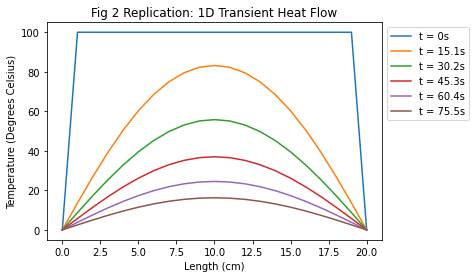

In [ ]:
# Plot the result

# x range
test_1d_x = [i * test_1d_spacing for i in range(test_1d_length)]

for i in range(0, len(test_1d.times), test_1d_framesPerPlottedTime):
  plt.plot(test_1d_x, test_1d.tempFrames[i], label="t = " + str(round(test_1d.times[i], 1)) + "s")

# plot title, etc
plt.title("Fig 2 Replication: 1D Transient Heat Flow")
plt.xlabel("Length (cm)")
plt.ylabel("Temperature (Degrees Celsius)")
plt.legend(bbox_to_anchor=(1,1))

plt.show()

# animate the time evolution
animate1D(test_1d_x, test_1d.tempFrames, "1D Transient Heat Flow Time Evolution", xlabel="Length (cm)", ylabel="Temperature (Degrees Celsius)", fps=20)

### <ins>Replicating FIgure 3: Spherical Heat Dissipation

Figure 3 in the research paper displays the heat dissipation inside of a sphere. The temperature is initially distributed with spherical symmetry, 100$^\circ$ Celsius in the range [0cm, 25cm), and 0$^\circ$ Celsius at the radius 25cm. Thus the temperature evolves with spherical symmetry, and we can numerically simulate the evolution of the radial temperature distribution. Similar to figure 2, figure 3 displays the temperature distribution at several specific times.

The physical constants are all the same as in figure 2, simulating the situation in which a copper sphere comes to thermal equilibrium at 100$^\circ$ Celsius, and is then immersed in an ice bath at 0$^\circ$ Celsius.

Below, I have computed, plotted and animated this simulation, and if compared with figure 3 in the research paper, it's clear to see that they are identical. This confirms the validity of my radial heat flow simulation.

In [ ]:
# Physical constants from the paper
test_sphere_length = 26 # cm, fig 3 goes from radius 0 to 25 cm inclusive
test_sphere_timeDif = test_1d_timeDif # sec, same as from Fig 2
test_sphere_spacing = test_1d_spacing # cm, same as from Fig 2
test_sphere_diffusivity = test_1d_diffusivity # cm^2 / sec, copper just as in Fig 2
test_sphere_internalTemp = test_1d_internalTemp # degrees Celsius, initial temperature inside sphere
test_sphere_boundaryTemp = test_1d_boundaryTemp # degrees Celsius, boundaries held at this temp

# Plotting constants from the paper
test_sphere_maxTime = 151 # sec, the maximum simulation time required to replicate Fig 3 in the paper
test_sphere_plottedTimesInterval = 30.2 # distance between times plotted in Fig 3 in the paper
test_sphere_framesPerPlottedTime = FPS # number of frames to save per time plotted in the original paper
test_sphere_recordPeriod = round(test_sphere_plottedTimesInterval / test_sphere_timeDif / test_sphere_framesPerPlottedTime) # simulation steps between recorded frames


# Create spherical transient heat flow state
test_sphere = SphericalHeatState(test_sphere_length, 
                                 timeDif=test_sphere_timeDif, 
                                 spacing=test_sphere_spacing, 
                                 initDiffusivity=test_sphere_diffusivity, 
                                 initTemp=test_sphere_internalTemp, 
                                 recordPeriod=test_sphere_recordPeriod)

# Set boundary conditions of temperature
test_sphere.temp[-1] = test_sphere_boundaryTemp

# Simulate
test_sphere.repeatSimulationSteps(math.ceil(test_sphere_maxTime / test_sphere_timeDif))

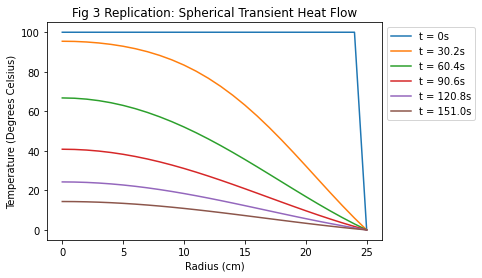

In [ ]:
# Plot the result

# x range
test_sphere_x = [i * test_sphere_spacing for i in range(test_sphere_length)]

for i in range(0, len(test_sphere.times), test_sphere_framesPerPlottedTime):
  plt.plot(test_sphere_x, test_sphere.tempFrames[i], label="t = " + str(round(test_sphere.times[i], 1)) + "s")

# plot title, etc
plt.title("Fig 3 Replication: Spherical Transient Heat Flow")
plt.xlabel("Radius (cm)")
plt.ylabel("Temperature (Degrees Celsius)")
plt.legend(bbox_to_anchor=(1,1))

plt.show()

# animate the time evolution
animate1D(test_sphere_x, test_sphere.tempFrames, "Radial Transient Heat Flow Time Evolution", xlabel="Radius (cm)", ylabel="Temperature (Degrees Celsius)", fps=FPS)

### <ins>Replicating Figure 4: Time Varying Spherical Heat Flow

In order to replicate Figure 4 in the research paper, I had to create a new subclass of SphericalHeatState, with the minor adjustment that after each simulation step, the boundary temperature is adjusted according to an arbitrary function of time.

Figure 4 displays the temperature evolution of a copper sphere with a sinusoidally oscillating boundary temperature. Unlike the previous two simulations, the initial temperature distribution is a uniform 0$^\circ$ Celsius. Unfortunately, the authors don't specify the all of the physical conditions used, and so I had to make some educated guesses.
* They specify that the sphere simulated is made of copper, so I use the same diffusivity as in the previous two simulations.
* They don't specify the timing of the simulation steps or the spacing of the lattice sites, so I assume they are unchanged from the previous two simulations.
* They don't specify the amplitude of the sinusoidal boundary, but given that their graph shows a maximum of 100$^\circ$ Celsius and that is the maximum used in the previous two experiments, I assume that the amplitude is 100$^\circ$ Celsius.
* They don't specify the frequency of the sinusoidal boundary, and there are an infinite number of frequencies which match the boundary conditions at the plotted times. I have assumed the lowest angular frequency (n = 0), but will show the results for n = 1 too (for reasons that will soon become clear).

\begin{align}
(n + \frac{1}{4}) * \frac{2 \pi}{\omega} = 30.2 s \;\;\;\;\;\;\;\; n = 0,1,2,3...
\end{align}

\

Interestingly, the plot I've created, attempting to match Figure 4's conditions exactly, does not match Figure 4. It's behavior is roughly similar, but the temperature of the center of the sphere acts very differently. In Figure 4, the temperature at the center of the sphere is consistently rising, even up to time t = 120.8s. In my simulation, the central temperature rises only until time t = 90.6s. 

I've investigated this difference by highlighting the wavelike properties of this system and looking at the behavior of the peaks/maximums of the distribution. In Figure 4, the central temperature keeps rising throughout the plotted times because the peak has yet to reach the center of the sphere. At time t = 60.4, Figure 4 peaks at around r = 20cm. However, in my plot, the central temperature begins to lower because the peak has already passed through it. At time t = 60.4s, the peak of my simulation is at around r = 17cm, and is much wider. Waves in my simulation clearly move faster and spread out more than in Figure 4. 

Below the first plots, I will look at several different configurations to see if we can isolate why my simulation acts differently than Figure 4.

In [ ]:
# Physical constants from the paper
# All physical constants are the same as from Figure 3, except the initial temperature and boundary temperature
test_timeVary_length = test_sphere_length
test_timeVary_timeDif = test_sphere_timeDif
test_timeVary_spacing = test_sphere_spacing
test_timeVary_diffusivity = test_sphere_diffusivity
test_timeVary_internalTemp = 0 # Degrees Celsius, temperature inside the sphere begins uniformly at 0.

# Boundary function
test_timeVary_boundaryPeriod = 120.8 # seconds for the sinusoidal boundary temperature to do a full oscillation, determined by inspecting Figure 4
test_timeVary_boundaryAmplitude = 100 # Degrees Celsius, the amplitude of the sinusoidal boundary temperature, determined by inspecting Figure 4
test_timeVary_boundaryFunction = lambda t : test_timeVary_boundaryAmplitude * math.sin(2 * math.pi / test_timeVary_boundaryPeriod * t)

# Plotting constants
test_timeVary_maxTime = 120.8 # seconds, the largest plotted time in figure 4 has t = 120.8 s
test_timeVary_plottedTimesInterval = 30.2 # seconds, lines are plotted at 30.2 second intervals
test_timeVary_framesPerPlottedTime = FPS # save <FPS> frames between plotted lines, allowing us to animate it at <FPS> fps, 1 second between plotted lines
test_timeVary_recordPeriod = round(test_timeVary_plottedTimesInterval / test_timeVary_framesPerPlottedTime / test_timeVary_timeDif) # steps per recorded frame
test_timeVary_stepsTilMaxTime = math.ceil(test_timeVary_maxTime / test_timeVary_timeDif) # The number of steps to simulate in order to reach the max time plotted in Figure 4

# Create state
test_timeVary = TimeVaryingSphericalHeatState(test_timeVary_length, 
                                              boundaryFunc=test_timeVary_boundaryFunction,
                                              timeDif=test_timeVary_timeDif,
                                              spacing=test_timeVary_spacing,
                                              initDiffusivity=test_timeVary_diffusivity,
                                              initTemp=test_timeVary_internalTemp,
                                              recordPeriod=test_timeVary_recordPeriod)

# Simulate for 4 times longer than necessary to show more behavior in the animation
test_timeVary.repeatSimulationSteps(4 * test_timeVary_stepsTilMaxTime)

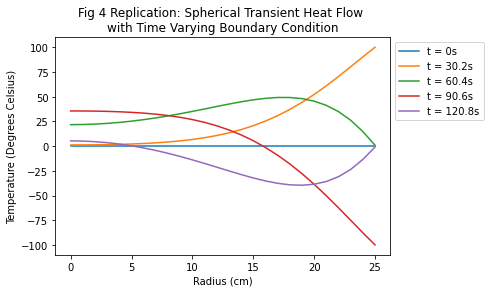

In [ ]:
# Plot the result

# x range
test_timeVary_x = [i * test_timeVary_spacing for i in range(test_timeVary_length)]

for i in range(0, math.ceil(test_timeVary_stepsTilMaxTime / test_timeVary_recordPeriod), test_timeVary_framesPerPlottedTime):
  plt.plot(test_timeVary_x, test_timeVary.tempFrames[i], label="t = " + str(round(test_timeVary.times[i], 1)) + "s")

# plot title, etc
plt.title("Fig 4 Replication: Spherical Transient Heat Flow \nwith Time Varying Boundary Condition")
plt.xlabel("Radius (cm)")
plt.ylabel("Temperature (Degrees Celsius)")
plt.legend(bbox_to_anchor=(1,1))

plt.show()


# animate the time evolution
animate1D(test_timeVary_x, test_timeVary.tempFrames, "Spherical Transient Heat Flow Time Evolution \nwith Time Varying Boundary Condition", 
          xlabel="Radius (cm)", ylabel="Temperature (Degrees Celsius)", fps=FPS)

#### Comparing to the Exact Solution

Appendix B of the paper gives the exact analytical solution to spherical heat flow with a sinusoidal boundary temperature, so before anything else, I can use that to recreate Figure 4, and confirm that Figure 4 displays a more accurate simulation than mine.

The exact solution is:

\begin{align}
T(r, t) = \frac{2 \pi^2 \alpha^2 T_0}{a^2} \sum_{N = 1}^{\infty} (-1)^{N - 1} N^2 \frac{\sin(\frac{N \pi r}{a}) \bigg( (\frac{N \pi \alpha}{a})^2 \sin \omega t - \omega \cos \omega t + \omega e^{-(\frac{N \pi \alpha}{a})^2 t} \bigg)}{\frac{N \pi r}{a} \big( (\frac{N \pi \alpha}{a} )^4 + \omega^2 \big)}
\end{align}

\begin{align}
T(0, t) = 3 T(1, t) - 3 T(2, t) + T(3, t)
\end{align}

\begin{align}
T(a, t) = T_0 \sin \omega t
\end{align}

Here, $T_0$ is the sinusoidal amplitude, $\omega$ is the sinusoidal angular frequency, $\alpha$ is the diffusivity, and $a$ is the radius of the sphere.

\

Below, I've plotted Figure 4 as predicted by the exact analytical solution. Surprisingly, this exact result almost exactly matches my simulation of Figure 4, and does not exhibit the behavior seen in Figure 4 itself. Because of this, I'm led to believe that the difference between my simulation and the simulation in the paper is due to a difference in physical constants that the authors did not mention. Below this plot, I will investigate the effects of changing various constants, in the hopes of finding the difference.

In [ ]:
'''
Computes the exact solution to the sinusoidal spherical heat flow problem for a list of 
positions and a given time.
Note, this function draws its constants from the test_timeVary constants in the previous cells. 
Don't redefine those constants elsewhere.

Args:
  rList ([double]): 1D list of positions to compute at. Must be in ascending order. (Unenforced restriction)
  t (double): time value to compute at.
'''
def timeVary_exactSol(rList, t):
  # define constants
  alph = test_timeVary_diffusivity # diffusivity
  a = (test_timeVary_length - 1) * test_timeVary_spacing # radius
  T0 = test_timeVary_boundaryAmplitude # sinusoidal amplitude
  w = 2 * math.pi / test_timeVary_boundaryPeriod # angular frequency

  # function accuracy constant, largest N to compute
  MAX_N = 100

  # compute value for each value of r, IN REVERSE ORDER SO WE FINISH WITH 0
  result = []
  for r in rList[::-1]:
    if r == a:
      T = T0 * math.sin(w * t)
      result.append(T)

    elif r == 0:
      T = 3 * result[-1] - 3 * result[-2] + result[-3] # since results are currently in reverse order
      result.append(T)

    else:
      coefficient = 2 * math.pi**2 * alph**2 * T0 / a**2

      # sum all N terms into this var
      accumulator = 0

      for N in range(1, MAX_N + 1):
        # begin creating the term for this N
        term = (-1)**(N - 1)
        
        term *= N**2

        term *= math.sin(N * math.pi * r / a)

        term *= (N * math.pi * alph / a)**2 * math.sin(w * t) - w * math.cos(w * t) + w * math.exp(-(N * math.pi * alph / a)**2 * t)

        term /= N * math.pi * r / a

        term /= (N * math.pi * alph / a)**4 + w**2

        accumulator += term

      T = coefficient * accumulator
      result.append(T)

  # reverse result list and return
  return result[::-1]

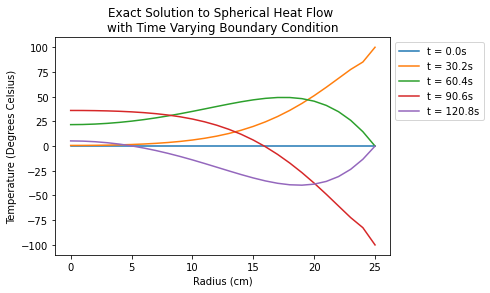

In [ ]:
# Recreate Figure 4 with exact solution

test_timeVaryExact_times = list(np.linspace(0, test_timeVary_maxTime, int(test_timeVary_maxTime / test_timeVary_plottedTimesInterval) + 1))
test_timeVaryExact_rList = list(np.linspace(0, (test_timeVary_length - 1) * test_timeVary_spacing, test_timeVary_length))

for t in test_timeVaryExact_times:
  plt.plot(test_timeVaryExact_rList, timeVary_exactSol(test_timeVaryExact_rList, t), label="t = " + str(round(t, 1)) + "s")

plt.title("Exact Solution to Spherical Heat Flow \nwith Time Varying Boundary Condition")
plt.xlabel("Radius (cm)")
plt.ylabel("Temperature (Degrees Celsius)")
plt.legend(bbox_to_anchor=(1,1))

plt.show()

#### Investigating Higher Frequency Boundary Conditions

Since the authors of the paper don't specify the exact angular frequency used in Figure 4, I initially assumed the lowest frequency, which places the 5 plotted times at angles $0, \frac{\pi}{2}, \pi, \frac{3 \pi}{2}, 2 \pi$, all within a single period of the sinusoidal boundary function. It is possible, however, that multiple periods occured between each plotted time. To investigate this, I have plotted and animated the results of using the next two higher, but still valid, frequencies. All other simulation parameters are the same.

From the plots and animations, we can see that at higher frequencies, temperature waves have very little time to travel inwards into the sphere before the sinusoidal boundary temperature reverses, pulling the internal sphere temperature in the opposite direction. The effects at the center of the sphere are minimal, and decrease with higher frequencies.

Thus, it's safe to say that the frequency used in creating Figure 4 in the paper is the original frequency I used, the lowest frequency consistent with the plotted times and values of the sinusoidal boundary function.

In the cells following these plots, I investigate other possible sources of the difference between my simulation and Figure 4.

In [ ]:
# Create new boundary functions
test_timeVaryHighFreq1_boundaryPeriod = 1 / 5 * test_timeVary_boundaryPeriod
test_timeVaryHighFreq1_boundaryFunction = lambda t : test_timeVary_boundaryAmplitude * math.sin(2 * math.pi / test_timeVaryHighFreq1_boundaryPeriod * t)

test_timeVaryHighFreq2_boundaryPeriod = 1 / 9 * test_timeVary_boundaryPeriod
test_timeVaryHighFreq2_boundaryFunction = lambda t : test_timeVary_boundaryAmplitude * math.sin(2 * math.pi / test_timeVaryHighFreq2_boundaryPeriod * t)

# Create state
test_timeVaryHighFreq1 = TimeVaryingSphericalHeatState(test_timeVary_length, 
                                              boundaryFunc=test_timeVaryHighFreq1_boundaryFunction,
                                              timeDif=test_timeVary_timeDif,
                                              spacing=test_timeVary_spacing,
                                              initDiffusivity=test_timeVary_diffusivity,
                                              initTemp=test_timeVary_internalTemp,
                                              recordPeriod=test_timeVary_recordPeriod)

test_timeVaryHighFreq2 = TimeVaryingSphericalHeatState(test_timeVary_length, 
                                              boundaryFunc=test_timeVaryHighFreq2_boundaryFunction,
                                              timeDif=test_timeVary_timeDif,
                                              spacing=test_timeVary_spacing,
                                              initDiffusivity=test_timeVary_diffusivity,
                                              initTemp=test_timeVary_internalTemp,
                                              recordPeriod=test_timeVary_recordPeriod)

# Simulate for 4 times longer than necessary to show more behavior in the animation
test_timeVaryHighFreq1.repeatSimulationSteps(4 * test_timeVary_stepsTilMaxTime)
test_timeVaryHighFreq2.repeatSimulationSteps(4 * test_timeVary_stepsTilMaxTime)

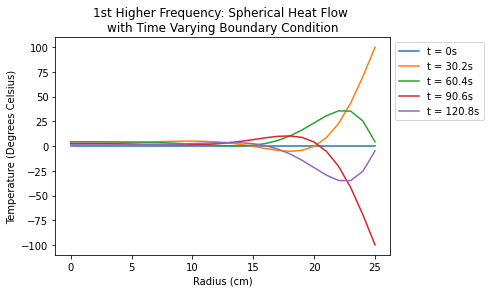

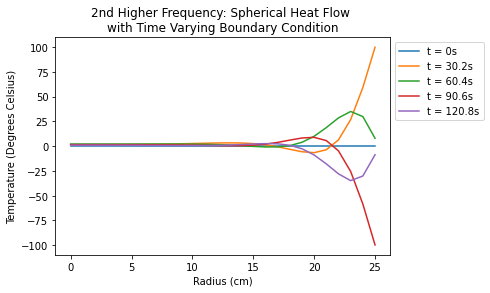

In [ ]:
# Plots

# 1st higher frequency
for i in range(0, math.ceil(test_timeVary_stepsTilMaxTime / test_timeVary_recordPeriod), test_timeVary_framesPerPlottedTime):
  plt.plot(test_timeVary_x, test_timeVaryHighFreq1.tempFrames[i], label="t = " + str(round(test_timeVaryHighFreq1.times[i], 1)) + "s")

# plot title, etc
plt.title("1st Higher Frequency: Spherical Heat Flow \nwith Time Varying Boundary Condition")
plt.xlabel("Radius (cm)")
plt.ylabel("Temperature (Degrees Celsius)")
plt.legend(bbox_to_anchor=(1,1))

plt.show()

# 2nd higher frequency
for i in range(0, math.ceil(test_timeVary_stepsTilMaxTime / test_timeVary_recordPeriod), test_timeVary_framesPerPlottedTime):
  plt.plot(test_timeVary_x, test_timeVaryHighFreq2.tempFrames[i], label="t = " + str(round(test_timeVaryHighFreq2.times[i], 1)) + "s")

# plot title, etc
plt.title("2nd Higher Frequency: Spherical Heat Flow \nwith Time Varying Boundary Condition")
plt.xlabel("Radius (cm)")
plt.ylabel("Temperature (Degrees Celsius)")
plt.legend(bbox_to_anchor=(1,1))

plt.show()


# Animations

animate1D(test_timeVary_x, test_timeVaryHighFreq1.tempFrames, "1st Higher Frequency: Spherical Heat Flow \nwith Time Varying Boundary Condition", 
          xlabel="Radius (cm)", ylabel="Temperature (Degrees Celsius)", fps=FPS)

animate1D(test_timeVary_x, test_timeVaryHighFreq2.tempFrames, "2nd Higher Frequency: Spherical Heat Flow \nwith Time Varying Boundary Condition", 
          xlabel="Radius (cm)", ylabel="Temperature (Degrees Celsius)", fps=FPS)

#### Testing Different Diffusivity Constants

Below, I have plotted and animated the behavior of my simulation with the original, slightly increased, and slightly decreased diffusivity. I've chosen the increased diffusivity to be small enough that we still satisfy the stability constraint.

\begin{align}
\alpha^+ = 1.3 * \alpha
\end{align}

\begin{align}
\alpha^- = 0.7 * \alpha
\end{align}

Perhaps unsurprisingly, a higher diffusivity leads to faster-moving waves and a larger peak width, since the waves are more diffuse. A lower diffusivity leads to slower moving waves which are more localized. Funnily enough, the graph produced with decreased diffusivity exhibits exactly the behavior shown in Figure 4, with consistently increasing central temperature.

Because of this, I can only conclude that in producing Figure 4, the authors of the paper used a lower diffusivity constant for copper than they used in Figures 2 and 3.

In [ ]:
# Simulations

test_timeVaryDiffusivityIncrease = TimeVaryingSphericalHeatState(test_timeVary_length, 
                                              boundaryFunc=test_timeVary_boundaryFunction,
                                              timeDif=test_timeVary_timeDif,
                                              spacing=test_timeVary_spacing,
                                              initDiffusivity=test_timeVary_diffusivity * 1.3,
                                              initTemp=test_timeVary_internalTemp,
                                              recordPeriod=test_timeVary_recordPeriod)

test_timeVaryDiffusivityDecrease = TimeVaryingSphericalHeatState(test_timeVary_length, 
                                              boundaryFunc=test_timeVary_boundaryFunction,
                                              timeDif=test_timeVary_timeDif,
                                              spacing=test_timeVary_spacing,
                                              initDiffusivity=test_timeVary_diffusivity * 0.7,
                                              initTemp=test_timeVary_internalTemp,
                                              recordPeriod=test_timeVary_recordPeriod)

# Simulate for 4 times longer than necessary to show more behavior in the animation
test_timeVaryDiffusivityIncrease.repeatSimulationSteps(4 * test_timeVary_stepsTilMaxTime)
test_timeVaryDiffusivityDecrease.repeatSimulationSteps(4 * test_timeVary_stepsTilMaxTime)

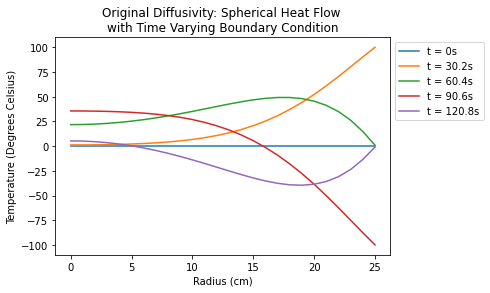

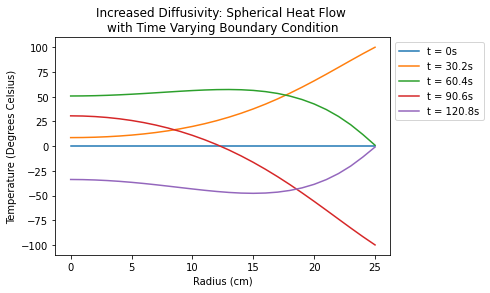

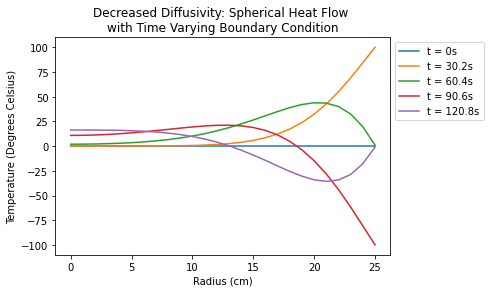

In [ ]:
# Plots

# Original diffusivity
for i in range(0, math.ceil(test_timeVary_stepsTilMaxTime / test_timeVary_recordPeriod), test_timeVary_framesPerPlottedTime):
  plt.plot(test_timeVary_x, test_timeVary.tempFrames[i], label="t = " + str(round(test_timeVary.times[i], 1)) + "s")

# plot title, etc
plt.title("Original Diffusivity: Spherical Heat Flow \nwith Time Varying Boundary Condition")
plt.xlabel("Radius (cm)")
plt.ylabel("Temperature (Degrees Celsius)")
plt.legend(bbox_to_anchor=(1,1))

plt.show()

# Increased diffusivity
for i in range(0, math.ceil(test_timeVary_stepsTilMaxTime / test_timeVary_recordPeriod), test_timeVary_framesPerPlottedTime):
  plt.plot(test_timeVary_x, test_timeVaryDiffusivityIncrease.tempFrames[i], label="t = " + str(round(test_timeVaryDiffusivityIncrease.times[i], 1)) + "s")

# plot title, etc
plt.title("Increased Diffusivity: Spherical Heat Flow \nwith Time Varying Boundary Condition")
plt.xlabel("Radius (cm)")
plt.ylabel("Temperature (Degrees Celsius)")
plt.legend(bbox_to_anchor=(1,1))

plt.show()

# Decreased diffusivity
for i in range(0, math.ceil(test_timeVary_stepsTilMaxTime / test_timeVary_recordPeriod), test_timeVary_framesPerPlottedTime):
  plt.plot(test_timeVary_x, test_timeVaryDiffusivityDecrease.tempFrames[i], label="t = " + str(round(test_timeVaryDiffusivityDecrease.times[i], 1)) + "s")

# plot title, etc
plt.title("Decreased Diffusivity: Spherical Heat Flow \nwith Time Varying Boundary Condition")
plt.xlabel("Radius (cm)")
plt.ylabel("Temperature (Degrees Celsius)")
plt.legend(bbox_to_anchor=(1,1))

plt.show()



# Animations
animate1D(test_timeVary_x, test_timeVary.tempFrames, "Original Diffusivity: Spherical Heat Flow \nwith Time Varying Boundary Conditions",
          "Radius (cm)", "Temperature (Degrees Celsius)", FPS)
animate1D(test_timeVary_x, test_timeVaryDiffusivityIncrease.tempFrames, "Increased Diffusivity: Spherical Heat Flow \nwith Time Varying Boundary Conditions",
          "Radius (cm)", "Temperature (Degrees Celsius)", FPS)
animate1D(test_timeVary_x, test_timeVaryDiffusivityDecrease.tempFrames, "Decreased Diffusivity: Spherical Heat Flow \nwith Time Varying Boundary Conditions",
          "Radius (cm)", "Temperature (Degrees Celsius)", FPS)

### <ins>Simulating Diffusivity Barriers

Out of curiosity, below I've animated two copper spheres with sinusoidal boundary conditions with an internal shell of increased or decreased, respectively. All of the conditions are the same as in the previous sinusoidal system, except the diffusivity from the radii r = 10cm to r = 15cm.

\begin{align}
\alpha_{low} = 0.5 * \alpha
\end{align}

\begin{align}
\alpha_{high} = 1.5 * \alpha
\end{align}

The results of this are interesting, but not exactly surprising. Inside the area of low diffusivity, incoming waves are damped, reducing the strength of the transmitted waves making their way to the center of the sphere. Inside the area of high diffusivity, waves transmit very easily, and the size of the waves making their way to the center of the sphere is increased.

In [ ]:
# diffusivities
test_timeVaryDiffusivityBarrierLow_barrierDiffusivity = 0.5
test_timeVaryDiffusivityBarrierHigh_barrierDiffusivity = 0.5


# Simulation Objects
test_timeVaryDiffusivityBarrierLow = TimeVaryingSphericalHeatState(test_timeVary_length, 
                                              boundaryFunc=test_timeVary_boundaryFunction,
                                              timeDif=test_timeVary_timeDif,
                                              spacing=test_timeVary_spacing,
                                              initDiffusivity=test_timeVary_diffusivity,
                                              initTemp=test_timeVary_internalTemp,
                                              recordPeriod=test_timeVary_recordPeriod)
test_timeVaryDiffusivityBarrierHigh = TimeVaryingSphericalHeatState(test_timeVary_length, 
                                              boundaryFunc=test_timeVary_boundaryFunction,
                                              timeDif=test_timeVary_timeDif,
                                              spacing=test_timeVary_spacing,
                                              initDiffusivity=test_timeVary_diffusivity,
                                              initTemp=test_timeVary_internalTemp,
                                              recordPeriod=test_timeVary_recordPeriod)

# Create diffusivity barrier and well
test_timeVaryDiffusivityBarrierLow.diffusivity[10:16] *= 0.5
test_timeVaryDiffusivityBarrierHigh.diffusivity[10:16] *= 1.5

# simulations
test_timeVaryDiffusivityBarrierLow.repeatSimulationSteps(4 * test_timeVary_stepsTilMaxTime)
test_timeVaryDiffusivityBarrierHigh.repeatSimulationSteps(4 * test_timeVary_stepsTilMaxTime)

In [ ]:
animate1D(test_timeVary_x, test_timeVaryDiffusivityBarrierLow.tempFrames, "Low Diffusivity Barrier: Spherical Heat Flow \nwith Time Varying Boundary Conditions",
          "Radius (cm)", "Temperature (Degrees Celsius)", FPS)
animate1D(test_timeVary_x, test_timeVaryDiffusivityBarrierHigh.tempFrames, "High Diffusivity Barrier: Spherical Heat Flow \nwith Time Varying Boundary Conditions",
          "Radius (cm)", "Temperature (Degrees Celsius)", FPS)

### <ins>Experimenting With Two Dimensional Heat Flow

Out of curiosity, since I gave my HeatState class the ability to work with lattices with multiple dimensions, I will now investigate the behavior of two dimensional transient heat flow simulations.

In my first attempt, I've left most constants at 1, and set timeDif to 0.5, constants that would barely be stable in the one dimensional case. Any larger, and one dimensional errors would grow over time. 

With lattices of size 128x128, these heat flow simulations take long enough that I created progress logging functionality into my HeatState class. During long simulations, around once every 2 seconds, a HeatState object or child object will display its progress in a temporary and automatically updated line of text output. This output is erased when the simulation is finished.

In [ ]:
# Test constants
test_2d_animationDuration = 10 # seconds
test_2d_recordPeriod = 1
test_2d_timeDif = 0.5
test_2d_spacing = 1
test_2d_diffusivity = 1

'''
Runs a test of how a two-dimensional square at 100 degrees Celsius dissipates through sides held at 0 degrees Celsius.
Uses the current values of relevant test_2d_ constants.
'''
def dissipationTest2D():
  test_2d = HeatState(2, 128, 
                 timeDif = test_2d_timeDif, 
                 spacing = test_2d_spacing, 
                 initTemp = 100,
                 recordPeriod = test_2d_recordPeriod)

  # Set boundary conditions
  test_2d.temp[:,0] = np.zeros(128)
  test_2d.temp[:,-1] = np.zeros(128)
  test_2d.temp[0,:] = np.zeros(128)
  test_2d.temp[-1,:] = np.zeros(128)

  # Simulate
  test_2d.repeatSimulationSteps(test_2d_animationDuration * FPS * test_2d_recordPeriod)

  # Animate
  animate2D(test_2d.tempFrames, "Two Dimensional Heat Dissipation\n(timeDif = " + str(test_2d_timeDif) + ")", fps=FPS)

dissipationTest2D()

This checkerboard phenomenon originates at the corners of the simulation, because in the first simulation step, the corner non-boundary lattice sites experience twice change in temperature as the other sites neighboring the boundary. This effect propogates to sites neighboring the corner site, which in the next step experience a larger change in temperature than their own neighbors, due to being next to the abnormal corner site.

To try to avoid this phenomenon, I attempt the experiment again in the cell below, but with a lower value of timeDif ($\Delta t$). This should push the constants further below the stability value mentioned in the paper, dampen temperature changes, and hopefully stop this runaway process.

In [ ]:
test_2d_timeDif = 0.4
dissipationTest2D()

In [ ]:
test_2d_timeDif = 0.3
dissipationTest2D()

In [ ]:
test_2d_timeDif = 0.2
dissipationTest2D()

In [ ]:
test_2d_timeDif = 0.1
dissipationTest2D()

We can see that timeDifs at or below 0.2 are stable, at least insofar as this checkerboard pattern goes. However, this leads to very slow heat dissipation, at least with lattices of this size. To view the process over its entirety, I've decreased the frequency of saving frames and increased the simulation duration.

It's interesting to note how the edges if the square of dissipating heat slowly round into a near-perfect circle.

In [ ]:
test_2d_timeDif = 0.2
test_2d_animationDuration = 30
test_2d_recordPeriod = 10

dissipationTest2D()

Finally, just for fun, I've included similar simulations where only particular boundaries of the lattice are heated to 100$^\circ$ Celsius, while the other boundaries are held at 0$^\circ$.

In [ ]:
test_2d = HeatState(2, 128, 
                 timeDif = test_2d_timeDif, 
                 spacing = test_2d_spacing, 
                 initTemp = 0,
                 recordPeriod = test_2d_recordPeriod)

# Set boundary conditions
test_2d.temp[:,0] = 100 * np.ones(128)

# Simulate
test_2d.repeatSimulationSteps(test_2d_animationDuration * FPS * test_2d_recordPeriod)

# Animate
animate2D(test_2d.tempFrames, "Two Dimensional Heat Flow Non-Uniform Boundary Conditions", fps=FPS)

In [ ]:
test_2d = HeatState(2, 128, 
                 timeDif = test_2d_timeDif, 
                 spacing = test_2d_spacing, 
                 initTemp = 0,
                 recordPeriod = test_2d_recordPeriod)

# Set boundary conditions
test_2d.temp[:,0] = 100 * np.ones(128)
test_2d.temp[0,:] = 100 * np.ones(128)

# Simulate
test_2d.repeatSimulationSteps(test_2d_animationDuration * FPS * test_2d_recordPeriod)

# Animate
animate2D(test_2d.tempFrames, "Two Dimensional Heat Flow Non-Uniform Boundary Conditions", fps=FPS)

In [ ]:
test_2d = HeatState(2, 128, 
                 timeDif = test_2d_timeDif, 
                 spacing = test_2d_spacing, 
                 initTemp = 0,
                 recordPeriod = test_2d_recordPeriod)

# Set boundary conditions
test_2d.temp[:,0] = 100 * np.ones(128)
test_2d.temp[:,-1] = 100 * np.ones(128)

# Simulate
test_2d.repeatSimulationSteps(test_2d_animationDuration * FPS * test_2d_recordPeriod)

# Animate
animate2D(test_2d.tempFrames, "Two Dimensional Heat Flow Non-Uniform Boundary Conditions", fps=FPS)

In [ ]:
test_2d = HeatState(2, 128, 
                 timeDif = test_2d_timeDif, 
                 spacing = test_2d_spacing, 
                 initTemp = 0,
                 recordPeriod = test_2d_recordPeriod)

# Set boundary conditions
test_2d.temp[:,0] = 100 * np.ones(128)
test_2d.temp[:,-1] = 100 * np.ones(128)
test_2d.temp[0,:] = 100 * np.ones(128)

# Simulate
test_2d.repeatSimulationSteps(test_2d_animationDuration * FPS * test_2d_recordPeriod)

# Animate
animate2D(test_2d.tempFrames, "Two Dimensional Heat Flow Non-Uniform Boundary Conditions", fps=FPS)

## <ins>**Conclusion**

Throughout this project, I've created algorithms inspired by the equations in **Numerical Solution to Transient Heat Flow Problems**, by Ronald A. Kobiske and Jeffrey L. Hock. I've managed to exactly replicate Figures 2 and 3 in their paper, and additionally replicated Figure 4 to the best of my ability, confirming my simulation's accuracy despite the authors silently changing the diffusivity they used in creating Figure 4.

Out of curiosity, and an urge to play with my simulator, I continued after this to see how transient heat flow, and the waves created by an oscillating boundary temperature, behaved when passing through a region of adjusted diffusivity.

Next, I've shown the behavior of my simulator in the two dimensional case, avoiding an interesting checkerboard pattern which corrupts my state, propogating inwards from the corners of the lattice. After lowering the magnitude of temperature changes by lowering the time difference ($\Delta t$) of my simulations, I used it to picture the spread of heat through square lattices in which the side boundaries are held at different temperatures.

Overall, this project proved to be an interesting and enjoyable end to my experience in the Physics 180N Class, and an inspiration to continue exploring the intersections of Physics and Computation. Thank you for a great class, even in extremely unusual circumstances.